<a href="https://colab.research.google.com/github/moey920/Object-Detection/blob/master/Detectron2_Tutorial.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Detectron2 Tutorial
Translated and Updated by [visionNoob](https://github.com/visionNoob)  
([원문](https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5#scrollTo=roTj1N9F5uJ5)에서 내용이 각색되었습니다. 특히 Object Detection 관련 내용이 추가되었습니다)

<img src="https://dl.fbaipublicfiles.com/detectron2/Detectron2-Logo-Horz.png" width="500">

Detectron2에 오신것을 환영합니다! 이 튜토리얼 문서에서는 Detectron2의 기본적인 사용법을 다룹니다! 다루는 내용은 아래과 같습니다.

* Pretrained Model을 이미지와 비디오에 적용해보기
* 커스텀 데이터셋으로 detectron2 모델 학습시키기 

이 튜토리얼 문서를 활용해서 다양한 시도를 해보시기 바랍니다. 

# Chapter 1: Detectron2 설치하기

In [0]:
# 종속 패키지(dependencies) 설치
!pip install -U torch torchvision cython
!pip install -U 'git+https://github.com/facebookresearch/fvcore.git' 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
torch.__version__

Requirement already up-to-date: torch in /usr/local/lib/python3.6/dist-packages (1.4.0)
Requirement already up-to-date: torchvision in /usr/local/lib/python3.6/dist-packages (0.5.0)
Requirement already up-to-date: cython in /usr/local/lib/python3.6/dist-packages (0.29.15)
  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-fuj35h0r
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-fuj35h0r
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-3_t6hz5_
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-3_t6hz5_
     |████████████████████████████████| 276kB 13.2MB/s 
  Created wheel for fvcore: filename=fvcore-0.1-cp36-none-any.whl size=39686 sha256=2ecf9cb92f3ea1d2c1bd7292b9dd909bfb75a4ddee0e33cb263f95169971c596
  Stored in directory: /tmp/pip-ephem-wheel-cache-hj49z8w_/wheels/48/53/79/3c6485543a4455a0006f5db590ab9957622b6227011941de06
  Created wheel 

'1.4.0'

In [0]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 89, done.
remote: Counting objects: 100% (89/89), done.
remote: Compressing objects: 100% (64/64), done.
remote: Total 3046 (delta 39), reused 48 (delta 25), pack-reused 2957
Receiving objects: 100% (3046/3046), 2.08 MiB | 4.11 MiB/s, done.
Resolving deltas: 100% (2035/2035), done.
Obtaining file:///content/detectron2_repo
     |████████████████████████████████| 61kB 4.9MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.dev200218-cp36-none-any.whl size=34524 sha256=1a5d7029a2e2bd933061974dc13a42079603a7aeac5e9cc5b40a2fa78d849747
  Stored in directory: /root/.cache/pip/wheels/82/60/b3/80aaba11ce2da9e43463bfb09643ab60ea05b1c7fe609c509e
Successfully built fvcore
ERROR: fvcore 0.1.dev200218 has requirement pyyaml>=5.1, but you'll have pyyaml 3.13 which is incompatible.
  Found existing installation: tqdm 4.28.1
    Uninstalling tqdm-4.28.1:
      Successfully uninstalled tqdm-4.28.1
  Running setup.py develop for detectron2


In [0]:
# 인스톨이 완료되면 Colab Runtime을 다시 시작해주세요. 

# 기본 설정
# detectron2 logger 설정
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# 자주 사용하는 라이브러리 임폴트
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# 자주 사용하는 detectron2 유틸 임폴트 
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

ModuleNotFoundError: ignored

# Chapter 2: 이미지에서 Pretrained Model(COCO 데이터셋) 사용해보기

임의의 데이터를 다운로드합니다.

--2020-02-20 01:58:27--  https://www.dropbox.com/s/qg3vbw8vij16e93/beatles-abbeyroad.jpg
Resolving www.dropbox.com (www.dropbox.com)... 162.125.65.1, 2620:100:6021:1::a27d:4101
Connecting to www.dropbox.com (www.dropbox.com)|162.125.65.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/qg3vbw8vij16e93/beatles-abbeyroad.jpg [following]
--2020-02-20 01:58:28--  https://www.dropbox.com/s/raw/qg3vbw8vij16e93/beatles-abbeyroad.jpg
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc4c92c42e70792644d15163366c.dl.dropboxusercontent.com/cd/0/inline/AyakfuglNzO-qgpypXInyYiRU_t9Pcr7KkZvZpw-AcBjI-Ud4HmKyrklaBDs01vP8sY4_olpkF_UYKSSwrvkrXhqHUnhedOC2JbXQKanhV60s2Inezf2IoA-qjmpXnfTM_E/file# [following]
--2020-02-20 01:58:28--  https://uc4c92c42e70792644d15163366c.dl.dropboxusercontent.com/cd/0/inline/AyakfuglNzO-qgpypXInyYiRU_t9Pcr7KkZvZpw-AcBjI-Ud4HmKyrklaBDs01vP8sY4_olpkF_UYKSSwrvk

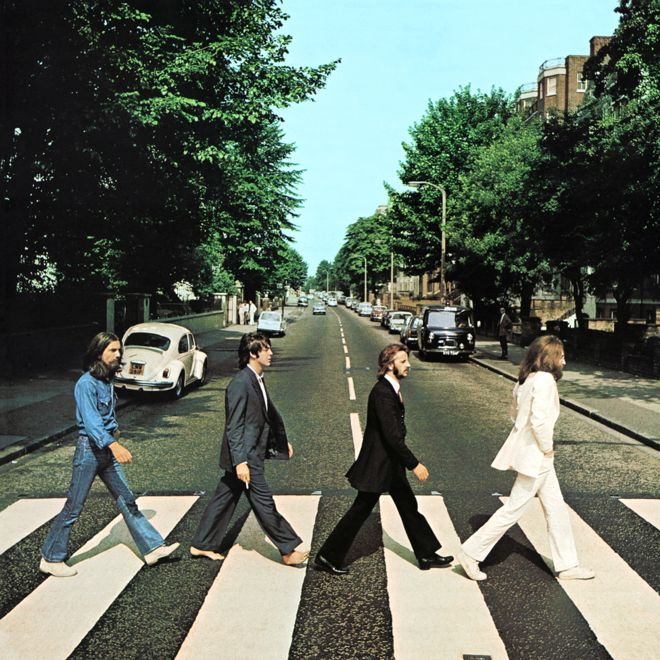

In [0]:
!wget 'https://www.dropbox.com/s/qg3vbw8vij16e93/beatles-abbeyroad.jpg' -O input.jpg
im = cv2.imread("./input.jpg")
cv2_imshow(im)

## 2.1. Object Detection (RetinaNet)

In [0]:
cfg = get_cfg()
# 각 테스크에 맞는 적절한 config을 추가해줍니다. 
cfg.merge_from_file("./detectron2_repo/configs/COCO-Detection/retinanet_R_50_FPN_3x.yaml")
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# detectron2 model zoo에서 다양한 모델을 사용할 수 있습니다.
cfg.MODEL.WEIGHTS = "detectron2://COCO-Detection/retinanet_R_50_FPN_3x/137849486/model_final_4cafe0.pkl"
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

Loading config ./detectron2_repo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.
model_final_4cafe0.pkl: 152MB [00:14, 10.8MB/s]                           


In [0]:
# 출력 형식에 관한 자세한 내용은 아래 주소를 참고하세요.
# https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
outputs["instances"].pred_classes
outputs["instances"].pred_boxes

Boxes(tensor([[ 40.6358, 333.9966, 181.8462, 571.8605],
        [180.2224, 332.4440, 308.6822, 565.9091],
        [319.9937, 343.9012, 458.5180, 570.7783],
        [455.5074, 334.1248, 591.9949, 587.4014],
        [114.5481, 319.3491, 208.9405, 397.0024],
        [257.6055, 310.7838, 285.4981, 337.6269],
        [386.3744, 311.6302, 411.2941, 334.0549],
        [354.2631, 302.2026, 372.1566, 317.0580],
        [312.0756, 303.5022, 325.8849, 315.3000],
        [497.4238, 307.6110, 515.6693, 359.1118]], device='cuda:0'))

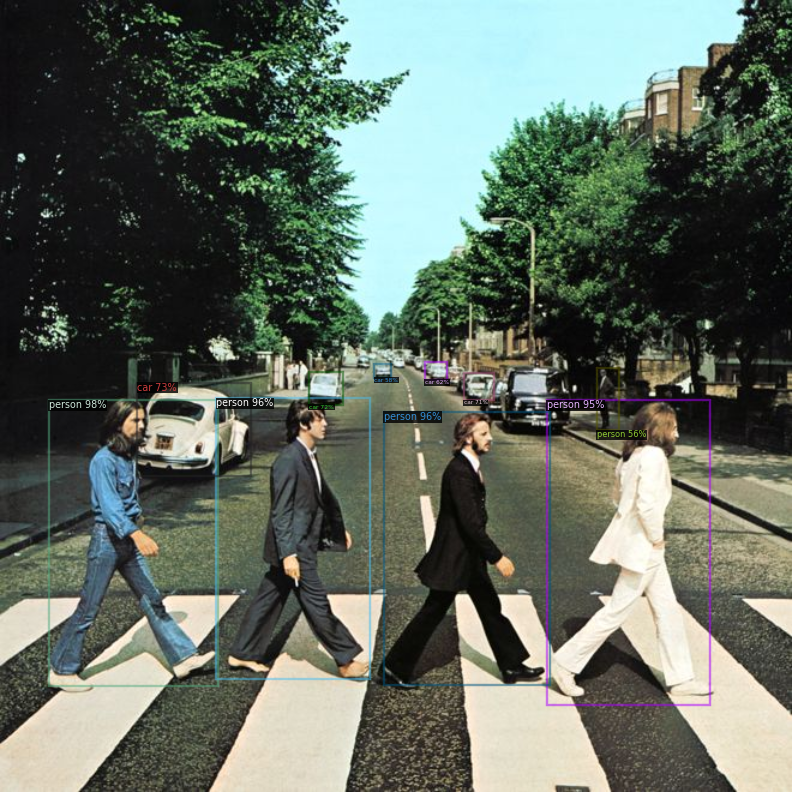

In [0]:
# `Visualizer`를 이용하면 예측 결과를 손쉽게 그릴 수 있습니다.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

## 2.2. Instance Segmentation (Mask RCNN)

우선 detectron2 모델을 사용하기 위해서는 `config`과 and `DefaultPredictor`이 필요합니다.

In [0]:
cfg = get_cfg()
# 각 테스크에 맞는 적절한 config을 추가해줍니다. 
cfg.merge_from_file("./detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# detectron2 model zoo에서 다양한 모델을 사용할 수 있습니다.
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

model_final_f10217.pkl: 178MB [00:15, 11.1MB/s]                           


In [0]:
# 출력 형식에 관한 자세한 내용은 아래 주소를 참고하세요.
# https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
outputs["instances"].pred_classes
outputs["instances"].pred_boxes

Boxes(tensor([[ 39.3791, 331.9544, 180.1522, 574.6418],
        [188.0837, 338.0056, 308.4779, 569.5318],
        [452.0458, 332.6617, 589.8115, 581.7493],
        [314.3315, 346.5156, 457.3985, 577.8179],
        [256.4161, 310.3341, 285.7166, 338.4565],
        [386.6102, 311.0589, 412.4352, 334.1367],
        [312.5240, 305.6327, 325.4646, 315.7699],
        [356.5841, 302.7808, 372.4295, 316.8270],
        [369.8478, 305.0507, 387.3161, 322.1160],
        [297.3444, 296.5375, 308.1571, 307.2129],
        [497.3776, 308.3015, 513.7375, 359.4036],
        [326.4428, 297.9355, 337.6827, 306.9364],
        [401.2532, 315.4321, 422.9165, 349.6924],
        [345.2956, 298.0413, 356.8431, 308.6130],
        [119.2872, 320.0363, 207.5051, 399.6386],
        [415.0161, 305.2044, 476.0468, 361.0343],
        [248.8858, 299.4326, 257.6233, 323.2185],
        [336.2272, 295.5576, 346.6370, 305.1942]], device='cuda:0'))

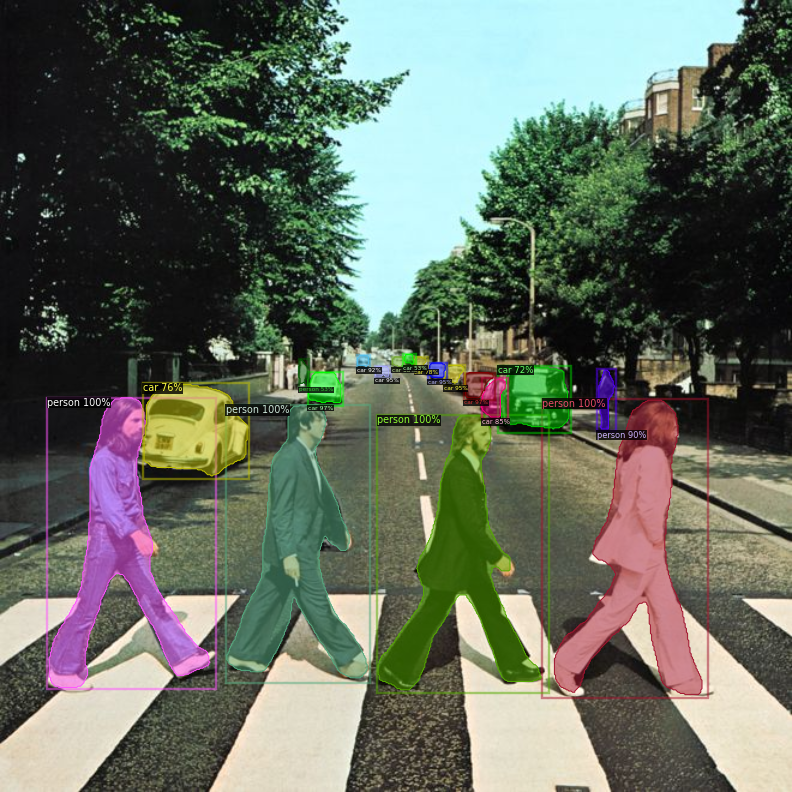

In [0]:
# `Visualizer`를 이용하면 예측 결과를 손쉽게 그릴 수 있습니다.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

## 2.3. Keypoints Detection (Keypoint RCNN)

In [0]:
# 이번에는 keypoint detection 모델을 사용해 보겠습니다.
cfg = get_cfg()
cfg.merge_from_file("./detectron2_repo/configs/COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7  # set threshold for this model
cfg.MODEL.WEIGHTS = "detectron2://COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x/137849621/model_final_a6e10b.pkl"
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

WARNING [12/08 09:37:14 d2.config.compat]: Config './detectron2_repo/configs/COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml' has no VERSION. Assuming it to be compatible with latest v2.


In [0]:
# 출력 형식에 관한 자세한 내용은 아래 주소를 참고하세요.
# https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
outputs["instances"].pred_classes
outputs["instances"].pred_boxes

Boxes(tensor([[458.1684, 334.3965, 593.4264, 581.8161],
        [187.2635, 334.2708, 314.4193, 564.7888],
        [313.7986, 344.3635, 459.8157, 572.3470],
        [ 37.0640, 330.6776, 176.8193, 576.5521],
        [497.3846, 306.4484, 512.6873, 359.6672]], device='cuda:0'))

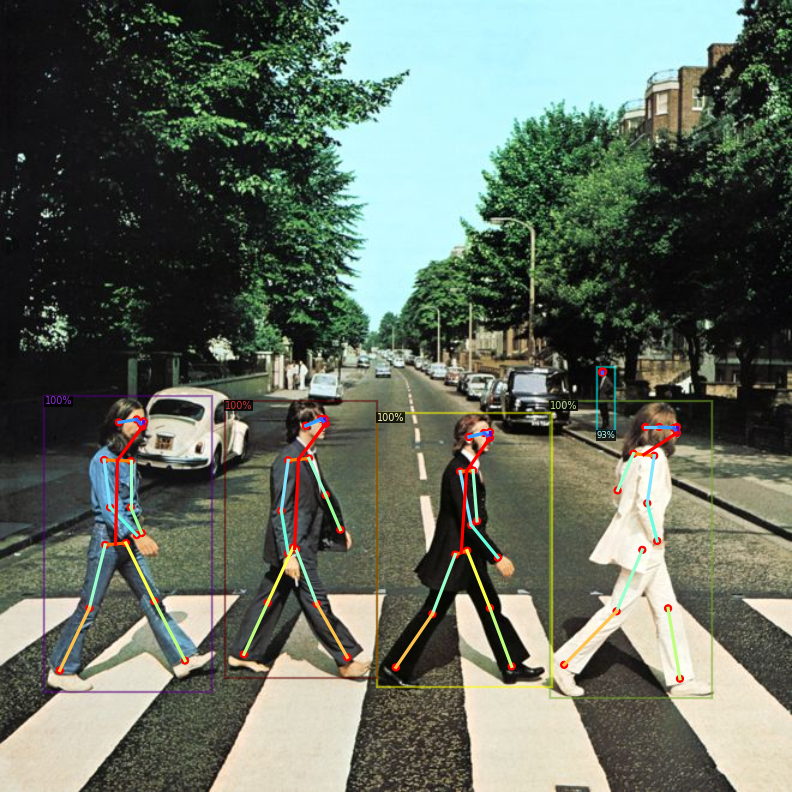

In [0]:
# `Visualizer`를 이용하면 예측 결과를 손쉽게 그릴 수 있습니다.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

## 2.4. Panoptic Segmentation

In [0]:
cfg = get_cfg()
cfg.merge_from_file("./detectron2_repo/configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml")
cfg.MODEL.WEIGHTS = "detectron2://COCO-PanopticSegmentation/panoptic_fpn_R_101_3x/139514519/model_final_cafdb1.pkl"
predictor = DefaultPredictor(cfg)
panoptic_seg, segments_info = predictor(im)["panoptic_seg"]

WARNING [12/08 09:37:31 d2.config.compat]: Config './detectron2_repo/configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml' has no VERSION. Assuming it to be compatible with latest v2.


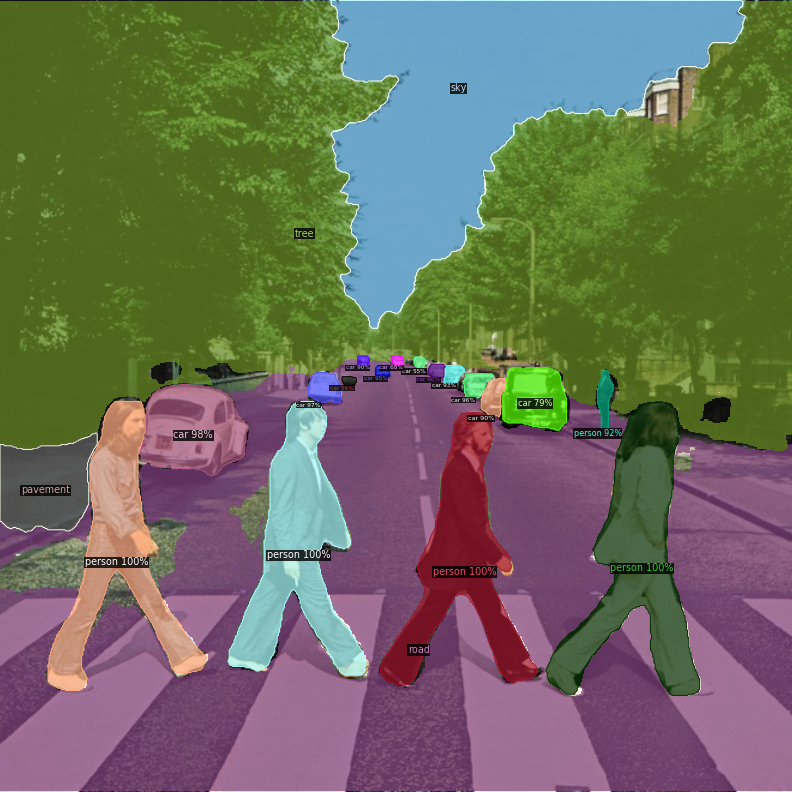

In [0]:
# `Visualizer`를 이용하면 예측 결과를 손쉽게 그릴 수 있습니다.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_panoptic_seg_predictions(panoptic_seg.to("cpu"), segments_info)
cv2_imshow(v.get_image()[:, :, ::-1])

# Chapter 3: 비디오에서 Pretrained Model(COCO 데이터셋) 사용해보기

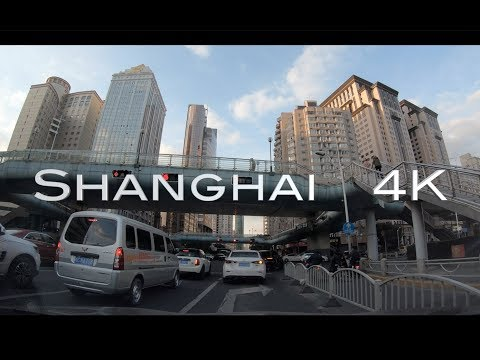

In [0]:
# 사용할 비디오를 YouTube에서 다운받습니다.
from IPython.display import YouTubeVideo, display
video = YouTubeVideo("ll8TgCZ0plk", width=500)
display(video)

In [0]:
# 종속 패키지들을 설치하고, 비디오를 다운로드받습니다, 다운로드 된 비디오는 5초만 잘라내서 사용합니다.
!pip install youtube-dl
!pip uninstall -y opencv-python opencv-contrib-python
!apt install python3-opencv
!youtube-dl https://www.youtube.com/watch?v=ll8TgCZ0plk -f 22 -o video.mp4
!ffmpeg -i video.mp4 -t 00:00:06 -c:v copy video-clip.mp4

     |████████████████████████████████| 1.8MB 2.8MB/s 
Uninstalling opencv-python-4.1.2.30:
  Successfully uninstalled opencv-python-4.1.2.30
Uninstalling opencv-contrib-python-4.1.2.30:
  Successfully uninstalled opencv-contrib-python-4.1.2.30
Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following packages were automatically installed and are no longer required:
  cuda-cufft-10-1 cuda-cufft-dev-10-1 cuda-curand-10-1 cuda-curand-dev-10-1
  cuda-cusolver-10-1 cuda-cusolver-dev-10-1 cuda-cusparse-10-1
  cuda-cusparse-dev-10-1 cuda-license-10-2 cuda-npp-10-1 cuda-npp-dev-10-1
  cuda-nsight-10-1 cuda-nsight-compute-10-1 cuda-nsight-systems-10-1
  cuda-nvgraph-10-1 cuda-nvgraph-dev-10-1 cuda-nvjpeg-10-1
  cuda-nvjpeg-dev-10-1 cuda-nvrtc-10-1 cuda-nvrtc-dev-10-1 cuda-nvvp-10-1
  libcublas10 libnvidia-common-430 nsight-compute-2019.5.0
  nsight-systems-2019.5.2
Use 'apt autoremove' to remove them.
The following NEW packages will be instal

## 3.1: Panoptic Segmentation

In [0]:
# 비디오의 각 프레임마다 panoptic segmentation을 수행합니다(3-4분 가량 소요됩니다).
# COCO 데이터셋으로 사전에 학습된 모델을 사용합니다.
!cd detectron2_repo && python demo/demo.py --config-file configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml --video-input ../video-clip.mp4 --confidence-threshold 0.6 --output ../video-output.mkv \
  --opts MODEL.WEIGHTS detectron2://COCO-PanopticSegmentation/panoptic_fpn_R_101_3x/139514519/model_final_cafdb1.pkl

Failed to load OpenCL runtime
[12/08 08:40:28 detectron2]: Arguments: Namespace(confidence_threshold=0.6, config_file='configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml', input=None, opts=['MODEL.WEIGHTS', 'detectron2://COCO-PanopticSegmentation/panoptic_fpn_R_101_3x/139514519/model_final_cafdb1.pkl'], output='../video-output.mkv', video_input='../video-clip.mp4', webcam=False)
WARNING [12/08 08:40:28 d2.config.compat]: Config 'configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml' has no VERSION. Assuming it to be compatible with latest v2.
model_final_cafdb1.pkl: 261MB [00:22, 11.7MB/s]               
100% 181/181 [02:19<00:00,  1.29it/s]


In [0]:
# 결과 비디오를 다운로드 받습니다.
from google.colab import files
files.download('./video-output.mkv')

## 3.2: Object Detection

In [0]:
# 비디오의 각 프레임마다 obect detection을 수행합니다(3-4분 가량 소요됩니다).
# COCO 데이터셋으로 사전에 학습된 모델을 사용합니다.
!cd detectron2_repo && python demo/demo.py --config-file configs/COCO-Detection/retinanet_R_50_FPN_3x.yaml --video-input ../video-clip.mp4 --confidence-threshold 0.6 --output ../video-output_det.mkv \
  --opts MODEL.WEIGHTS detectron2://COCO-Detection/retinanet_R_50_FPN_3x/137849486/model_final_4cafe0.pkl MODEL.RETINANET.SCORE_THRESH_TEST 0.5

Failed to load OpenCL runtime
[12/08 08:54:54 detectron2]: Arguments: Namespace(confidence_threshold=0.6, config_file='configs/COCO-Detection/retinanet_R_50_FPN_3x.yaml', input=None, opts=['MODEL.WEIGHTS', 'detectron2://COCO-Detection/retinanet_R_50_FPN_3x/137849486/model_final_4cafe0.pkl', 'MODEL.RETINANET.SCORE_THRESH_TEST', '0.5'], output='../video-output_det.mkv', video_input='../video-clip.mp4', webcam=False)
Loading config configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.
WARNING [12/08 08:54:54 d2.config.compat]: Config 'configs/COCO-Detection/retinanet_R_50_FPN_3x.yaml' has no VERSION. Assuming it to be compatible with latest v2.
100% 181/181 [00:45<00:00,  3.97it/s]


In [0]:
# 결과 비디오를 다운로드 받습니다.
from google.colab import files
files.download('./video-output_det.mkv')

# Chapter 4: 커스텀 데이터셋 학습하기

이번 챕터에서는 detectron2 모델을 활용하여 새로운 데이터셋을 학습시키는 방법을 설명합니다.

예시로, 클래스가 "풍선" 하나 뿐인, [풍선 세그멘테이션 데이터셋](https://github.com/matterport/Mask_RCNN/tree/master/samples/balloon)을 사용할 것입니다. 

detectron2 model zoo에서 제공하는 COCO 데이터셋으로 학습된 모델을 불러와서 풍선을 세그멘테이션하는 새로운 모델을 새롭게 학습시켜 보겠습니다.  

COCO 데이터셋에는 "풍선" 이라는 카테고리가 없습니다. 따라서 모델이 "풍선" 클래스를 학습할 수 있도록 모델을 조금 수정해야 합니다.



##  4.0 데이터셋 준비하기

In [0]:
# 데이터를 불러와서 압축을 해제합니다.
#!curl -O https://github.com/moey920/Object-Detection/releases/tag/1.0/dataset.zip
#!wget https://drive.google.com/drive/my-drive/dataset.zip

#!7z x dataset.zip
#!jar xvf dataset.zip

#!wget --spider https://github.com/moey920/Object-Detection/blob/test_file_upload/images/dataset.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 71839    0 71839    0     0  1753k      0 --:--:-- --:--:-- --:--:-- 1753k

7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs Intel(R) Xeon(R) CPU @ 2.00GHz (50653),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan         1 file, 71839 bytes (71 KiB)

Extracting archive: dataset.zip
ERROR: dataset.zip
dataset.zip
Open ERROR: Can not open the file as [zip] archive


ERRORS:
Is not archive
  0%    
Can't open as archive: 1
Files: 0
Size:       0
Compressed: 0


In [0]:
from google.colab import files
uploaded = files.upload()

for fn in uploaded.keys() :
  print('User uploaded file "{name}" with length {length} bytes.'.format(
      name=fn, length=len(uploaded[fn])))

Saving dataset.zip to dataset.zip
User uploaded file "dataset.zip" with length 441661157 bytes.


In [0]:
!ls
!cd val
!ls

dataset.zip  detectron2_repo  sample_data  train  val
dataset.zip  detectron2_repo  sample_data  train  val


In [0]:
!unzip dataset.zip # > /dev/null

Archive:  dataset.zip
replace train/001.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: train/001.jpg           
  inflating: train/002.jpg           
  inflating: train/003.jpg           
  inflating: train/004.jpg           
  inflating: train/005.jpg           
  inflating: train/006.jpg           
  inflating: train/007.jpg           
  inflating: train/008.jpg           
  inflating: train/009.jpg           
  inflating: train/010.jpg           
  inflating: train/011.jpg           
  inflating: train/012.jpg           
  inflating: train/013.jpg           
  inflating: train/014.jpg           
  inflating: train/015.jpg           
  inflating: train/016.jpg           
  inflating: train/017.jpg           
  inflating: train/018.jpg           
  inflating: train/019.jpg           
  inflating: train/020.jpg           
  inflating: train/021.jpg           
  inflating: train/022.jpg           
  inflating: train/023.jpg           
  inflating: train/024.jpg           
  i

"풍선 데이터셋"을 detectron2에 등록(Register)시킵니다.  
커스텀 데이터셋을 활용하는 자세한 내용은 [detectron2 커스텀 데이터셋 튜토리얼](https://detectron2.readthedocs.io/tutorials/datasets.html)을 참조하시기 바랍니다.


In [0]:
import os
import numpy as np
import json
from detectron2.structures import BoxMode
import itertools

# detectron2에서 데이터셋 정보를 로드하는 형식에 맞춰 함수를 작성합니다.
def get_receipt_dicts(img_dir):
    json_file = os.path.join(img_dir, "receipt_coco.json")
    with open(json_file) as f:
        imgs_anns = json.load(f)

    dataset_dicts = []
    for idx, v in enumerate(imgs_anns.values()):
        record = {}
        
        filename = os.path.join(img_dir, v["filename"])
        height, width = cv2.imread(filename).shape[:2]
        
        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width
      
        annos = v["regions"]
        objs = []
        for _, anno in annos.items():
            assert not anno["region_attributes"]
            anno = anno["shape_attributes"]
            px = anno["all_points_x"]
            py = anno["all_points_y"]
            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = list(itertools.chain.from_iterable(poly))

            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": 0,
                "iscrowd": 0
            }
            objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

from detectron2.data import DatasetCatalog, MetadataCatalog
for d in ["train", "val"]:
    DatasetCatalog.register("receipt_" + d, lambda d=d: get_balloon_dicts("receipt/" + d))
    MetadataCatalog.get("receipt_" + d).set(thing_classes=["receipt"])
balloon_metadata = MetadataCatalog.get("receipt_train")

ModuleNotFoundError: ignored

데이터가 제대로 로드되었는지 확인해봅니다.  
training set에서 샘플을 무작위로 선택하여 살펴봅니다.


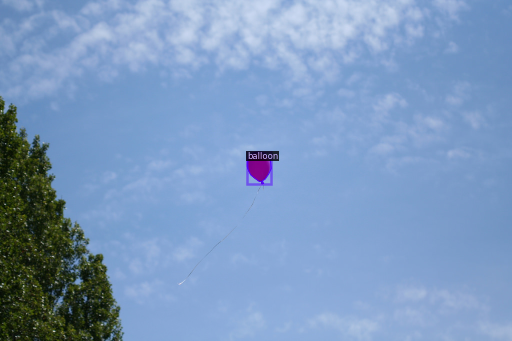

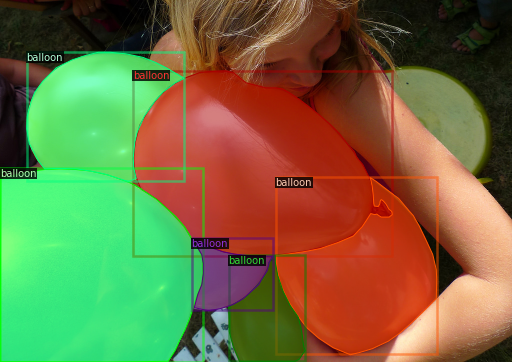

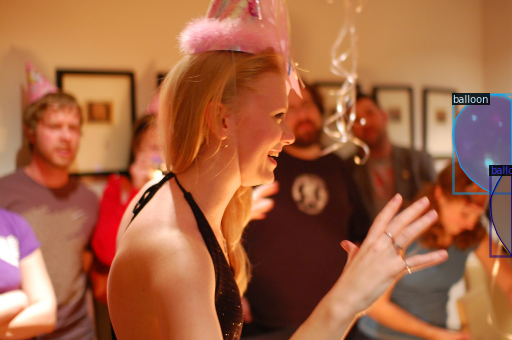

In [0]:
dataset_dicts = get_receipt_dicts("receipt/train")
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=balloon_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

## 4.2. Object Detection

### 4.2.1 학습하기

자 이제 학습을 진행할 단계입니다. 
COCO 데이터셋으로 학습된 R50-FPN RetinaNet 모델을 불러와서 풍선 데이터셋으로 fine-tune해 봅시다. 
Colab의 K80 GPU를 기준으로, 300 iterations 학습시키는데 대략 6분정도의 시간이 소요됩니다(P100 GPU의 경우 2분 가량 소요됩니다).

In [0]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file("./detectron2_repo/configs/COCO-Detection/retinanet_R_50_FPN_3x.yaml")
cfg.DATASETS.TRAIN = ("balloon_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "detectron2://COCO-Detection/retinanet_R_50_FPN_3x/137849486/model_final_4cafe0.pkl"  # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 300    # 300 iterations 정도면 충분합니다. 더 오랜 시간도 시도해보세요.
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # 풍선 데이터셋과 같이 작은 데이터셋에서는 이정도면 적당합니다.
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # 클래스는 "풍선" 클래스 하나 뿐입니다.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

Loading config ./detectron2_repo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


WARNING [12/08 10:11:32 d2.config.compat]: Config './detectron2_repo/configs/COCO-Detection/retinanet_R_50_FPN_3x.yaml' has no VERSION. Assuming it to be compatible with latest v2.
[12/08 10:11:33 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): 

OrderedDict()

In [0]:
# tensorboard를 사용해서 학습 커브를 살펴봅니다.
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 2246), started 0:04:13 ago. (Use '!kill 2246' to kill it.)

### 4.2.3 학습한 모델 실행 및 평가하기
자 이제 풍선 데이터셋의 검증(validation) 데이터셋으로 테스트를 해볼 차례입니다. 

우선, 방금 전 학습한 모델을 불러와서 `predictor`를 생성합니다.



In [0]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
cfg.DATASETS.TEST = ("balloon_val", )
predictor = DefaultPredictor(cfg)

샘플을 몇 개 뽑아 살펴봅니다.

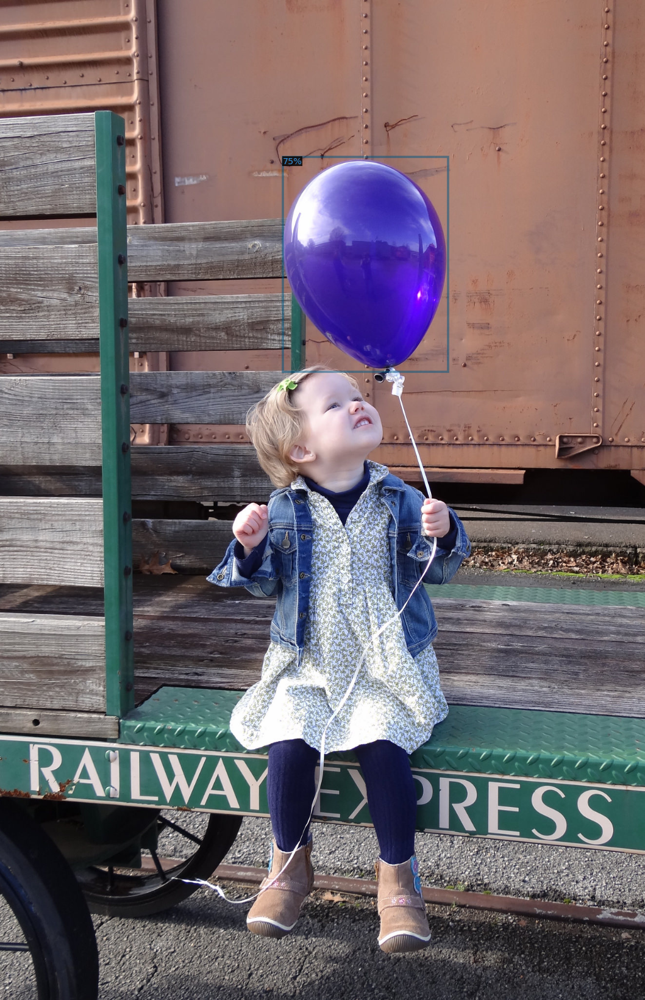

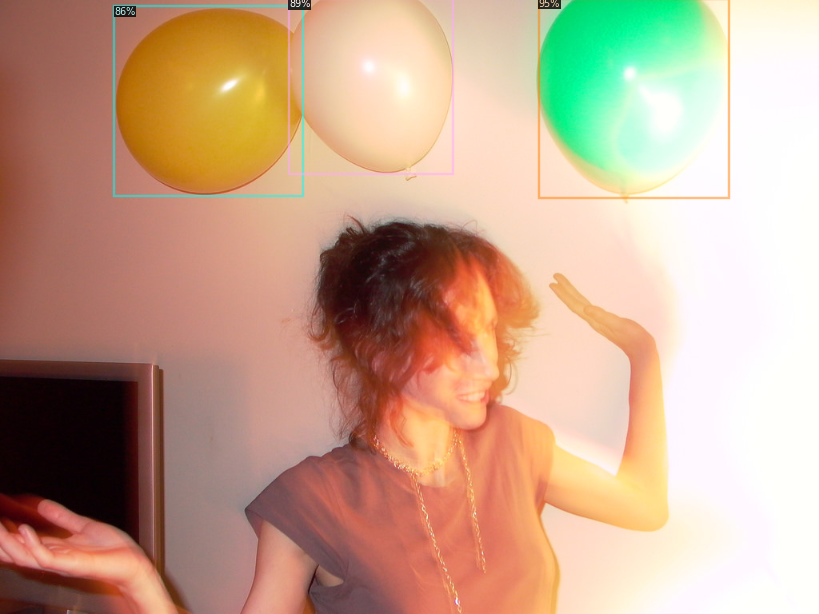

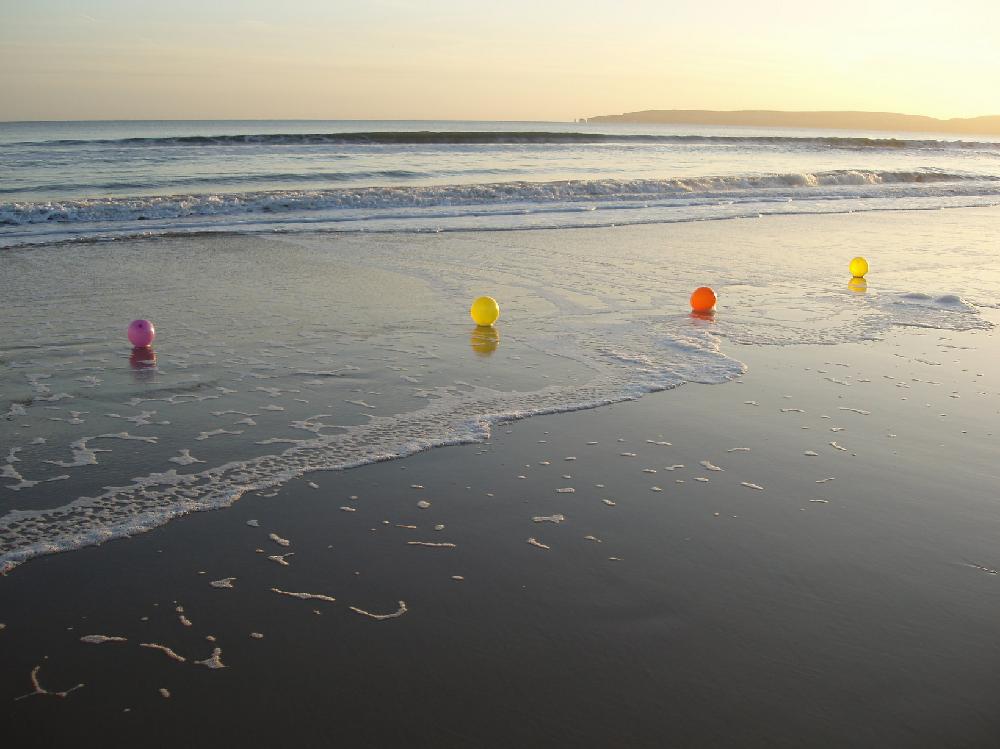

In [0]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_balloon_dicts("balloon/val")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=balloon_metadata, 
                   scale=0.8
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

유용한 기능: COCO API에 구현된 AP metric을 사용하여 성능을 측정할 수 있습니다.  
AP가 70%정도 됩니다. 나쁘지 않은 결과입니다!



In [0]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("balloon_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "balloon_val")
inference_on_dataset(trainer.model, val_loader, evaluator)
# another equivalent way is to use trainer.test

[12/08 10:15:54 d2.evaluation.evaluator]: Start inference on 13 images
[12/08 10:15:56 d2.evaluation.evaluator]: Total inference time: 0:00:00 (0.000000 s / img per device, on 1 devices)
[12/08 10:15:56 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.112266 s / img per device, on 1 devices)
[12/08 10:15:56 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[12/08 10:15:56 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[12/08 10:15:56 d2.evaluation.coco_evaluation]: Evaluating predictions ...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.08s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.687
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.796
 Average Precision  (AP) @[ IoU=0.75      | area

OrderedDict([('bbox',
              {'AP': 68.65505951281452,
               'AP50': 79.6052770715043,
               'AP75': 75.82696136364927,
               'APl': 87.40287753437015,
               'APm': 47.515563273221844,
               'APs': 27.8019801980198})])

## 4.2. Instance Segmentation

### 4.2.1 학습하기

자 이제 학습을 진행할 단계입니다. 
COCO 데이터셋으로 학습된 R50-FPN Mask R-CNN 모델을 불러와서 풍선 데이터셋으로 fine-tune해 봅시다. 
Colab의 K80 GPU를 기준으로, 300 iterations 학습시키는데 대략 6분정도의 시간이 소요됩니다(P100 GPU의 경우 2분 가량 소요됩니다).

In [0]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file("./detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.DATASETS.TRAIN = ("balloon_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"  # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 300    # 300 iterations 정도면 충분합니다. 더 오랜 시간도 시도해보세요.
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # 풍선 데이터셋과 같이 작은 데이터셋에서는 이정도면 적당합니다.
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # 클래스는 "풍선" 클래스 하나 뿐입니다.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

WARNING [12/08 10:05:46 d2.config.compat]: Config './detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml' has no VERSION. Assuming it to be compatible with latest v2.
[12/08 10:05:46 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
    

'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (2, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (2,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (4, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (4,) in the model! Skipped.
'roi_heads.mask_head.predictor.weight' has shape (80, 256, 1, 1) in the checkpoint but (1, 256, 1, 1) in the model! Skipped.
'roi_heads.mask_head.predictor.bias' has shape (80,) in the checkpoint but (1,) in the model! Skipped.


[12/08 10:05:51 d2.engine.train_loop]: Starting training from iteration 0
[12/08 10:05:58 d2.utils.events]: eta: 0:01:40  iter: 19  total_loss: 2.041  loss_cls: 0.652  loss_box_reg: 0.630  loss_mask: 0.689  loss_rpn_cls: 0.049  loss_rpn_loc: 0.008  time: 0.3623  data_time: 0.0055  lr: 0.000005  max_mem: 2799M
[12/08 10:06:05 d2.utils.events]: eta: 0:01:32  iter: 39  total_loss: 2.120  loss_cls: 0.629  loss_box_reg: 0.707  loss_mask: 0.663  loss_rpn_cls: 0.049  loss_rpn_loc: 0.011  time: 0.3608  data_time: 0.0065  lr: 0.000010  max_mem: 2799M
[12/08 10:06:12 d2.utils.events]: eta: 0:01:25  iter: 59  total_loss: 1.873  loss_cls: 0.564  loss_box_reg: 0.628  loss_mask: 0.591  loss_rpn_cls: 0.022  loss_rpn_loc: 0.006  time: 0.3596  data_time: 0.0087  lr: 0.000015  max_mem: 2799M
[12/08 10:06:20 d2.utils.events]: eta: 0:01:18  iter: 79  total_loss: 1.721  loss_cls: 0.493  loss_box_reg: 0.648  loss_mask: 0.532  loss_rpn_cls: 0.021  loss_rpn_loc: 0.006  time: 0.3629  data_time: 0.0077  lr: 0.0

OrderedDict()

In [0]:
# tensorboard를 사용해서 학습 커브를 살펴봅니다.
%load_ext tensorboard
%tensorboard --logdir output

### 4.2.3 학습한 모델 실행 및 평가하기
자 이제 풍선 데이터셋의 검증(validation) 데이터셋으로 테스트를 해볼 차례입니다. 

우선, 방금 전 학습한 모델을 불러와서 `predictor`를 생성합니다.



In [0]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
cfg.DATASETS.TEST = ("balloon_val", )
predictor = DefaultPredictor(cfg)

샘플을 몇 개 뽑아 살펴봅니다.

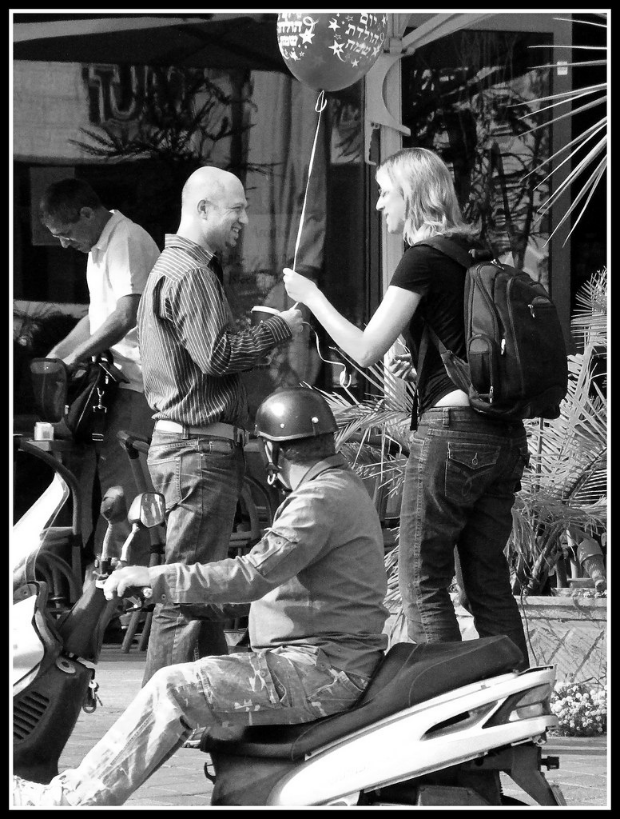

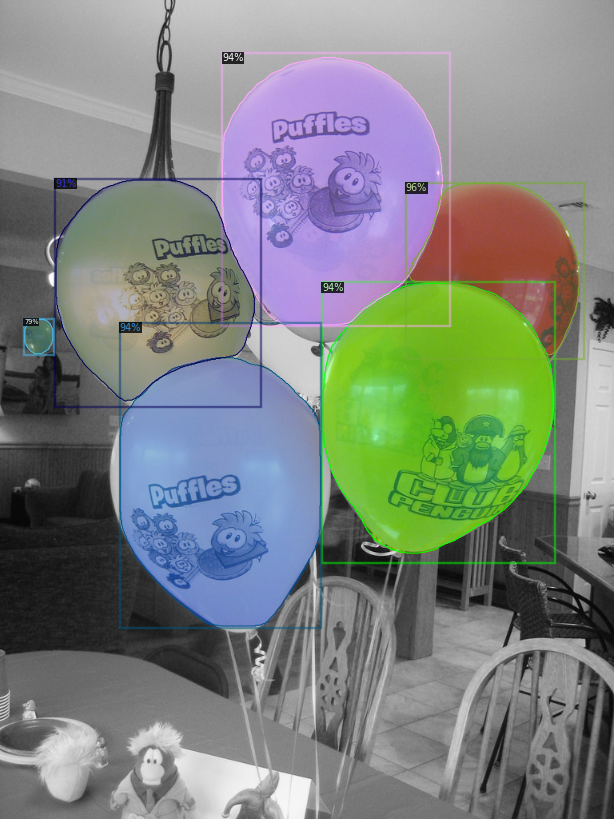

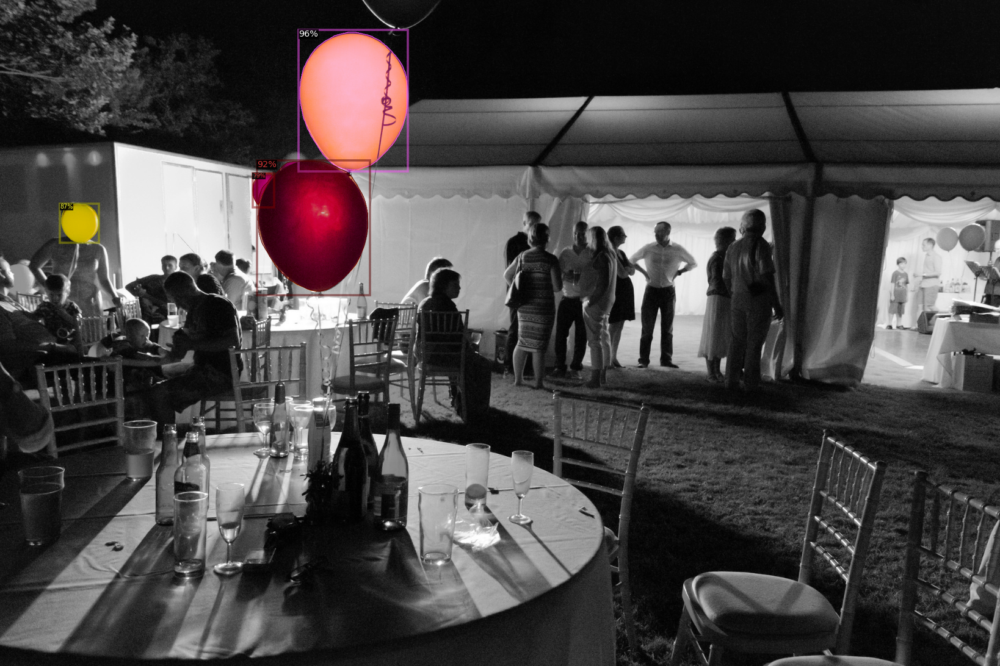

In [0]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_balloon_dicts("balloon/val")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=balloon_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

유용한 기능: COCO API에 구현된 AP metric을 사용하여 성능을 측정할 수 있습니다.  
AP가 70%정도 됩니다. 나쁘지 않은 결과입니다!



In [0]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("balloon_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "balloon_val")
inference_on_dataset(trainer.model, val_loader, evaluator)
# another equivalent way is to use trainer.test

WARNING [12/08 10:10:00 d2.evaluation.coco_evaluation]: json_file was not found in MetaDataCatalog for 'balloon_val'
[12/08 10:10:00 d2.data.datasets.coco]: Converting dataset annotations in 'balloon_val' to COCO format ...)
[12/08 10:10:00 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[12/08 10:10:00 d2.data.datasets.coco]: Conversion finished, num images: 13, num annotations: 50
[12/08 10:10:00 d2.data.datasets.coco]: Caching annotations in COCO format: ./output/balloon_val_coco_format.json
[12/08 10:10:01 d2.data.build]: Distribution of training instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|  balloon   | 50           |
|            |              |
[12/08 10:10:01 d2.evaluation.evaluator]: Start inference on 13 images
[12/08 10:10:09 d2.evaluation.evaluator]: Total inference time: 0:00:02 (0.250000 s / img per device, on 1 devices)
[12/08 10:10:09 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00

OrderedDict([('bbox',
              {'AP': 67.79747482658325,
               'AP50': 85.40716273981526,
               'AP75': 83.22154601000328,
               'APl': 80.9338070939188,
               'APm': 55.48325747570354,
               'APs': 21.124752475247522}),
             ('segm',
              {'AP': 77.32935178153633,
               'AP50': 84.90079940699584,
               'AP75': 83.5406988044036,
               'APl': 93.83750893500475,
               'APm': 57.917919637000026,
               'APs': 24.231966053748224})])